# ***lbfgs with 300 iteration same weights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


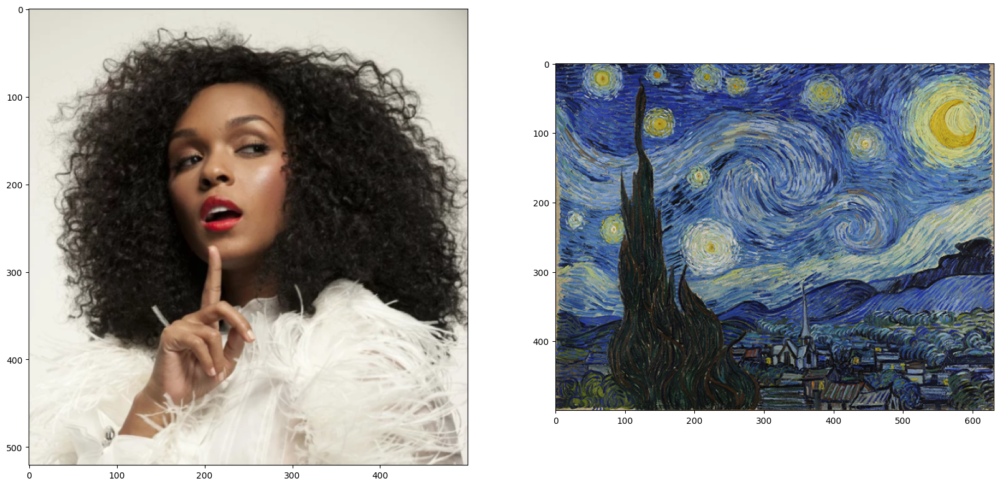

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer = optim.LBFGS([target.requires_grad_()])
alpha = 1
beta = 1e5
epochs = 300
show_every = 50

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

In [ ]:
results=[]
def closure():
    global target
    optimizer.zero_grad()
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    t_loss.backward()
    return t_loss

Iteration [0/300], Total Loss: 4383994.5000
Iteration [50/300], Total Loss: 6489.7646
Iteration [100/300], Total Loss: 5028.2891
Iteration [150/300], Total Loss: 4535.6646
Iteration [200/300], Total Loss: 4297.6021
Iteration [250/300], Total Loss: 4153.7207


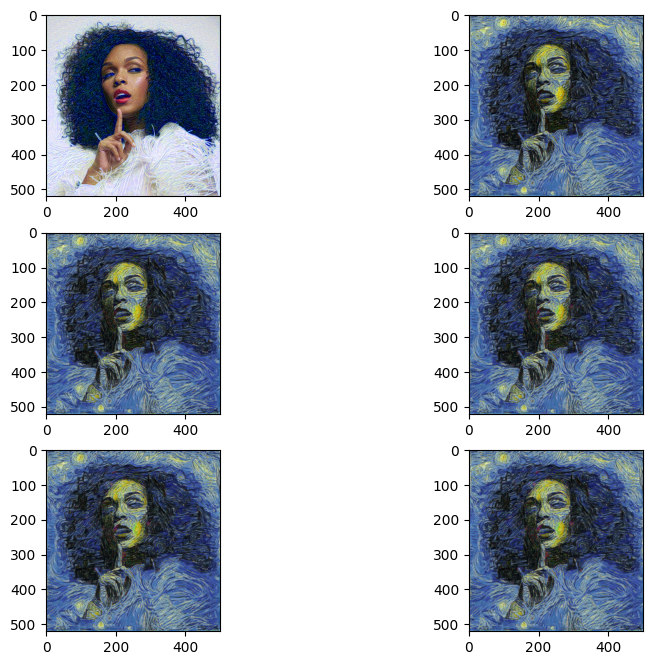

In [ ]:
for i in range(epochs):
    optimizer.step(closure)
    if i % show_every == 0:
        t_loss = closure()  # Calculate losses
        print("Iteration [{}/{}], Total Loss: {:.4f}".format(i, epochs, t_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()


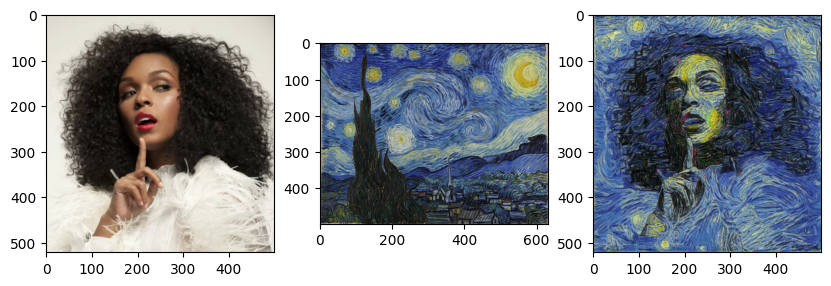

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

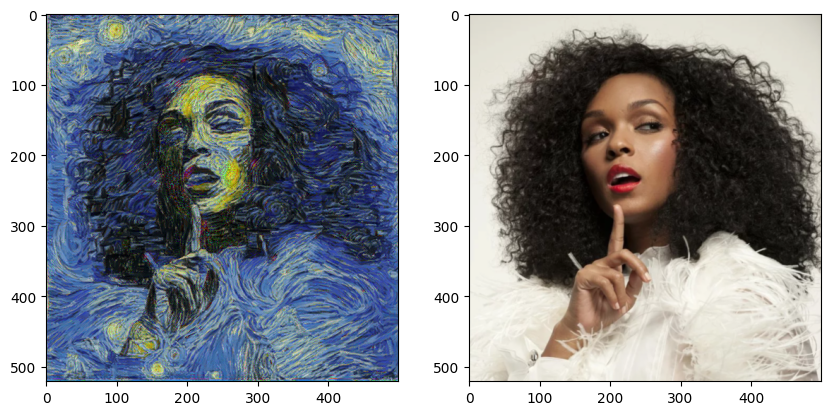

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***lbfgs with 300 iteration with change in wights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


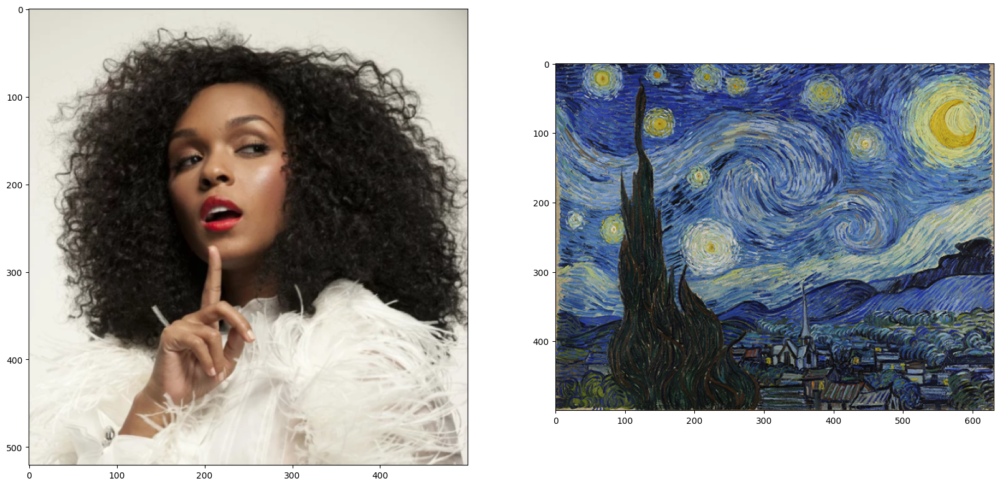

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer = optim.LBFGS([target.requires_grad_()])
alpha = 1
beta = 0.001
epochs = 300
show_every = 50

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

In [ ]:
results=[]
def closure():
    global target
    optimizer.zero_grad()
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    t_loss.backward()
    return t_loss

Epoch [0/300], Total Loss: 1.0358
Epoch [50/300], Total Loss: 0.0469
Epoch [100/300], Total Loss: 0.0346
Epoch [150/300], Total Loss: 0.0316
Epoch [200/300], Total Loss: 0.0304
Epoch [250/300], Total Loss: 0.0299


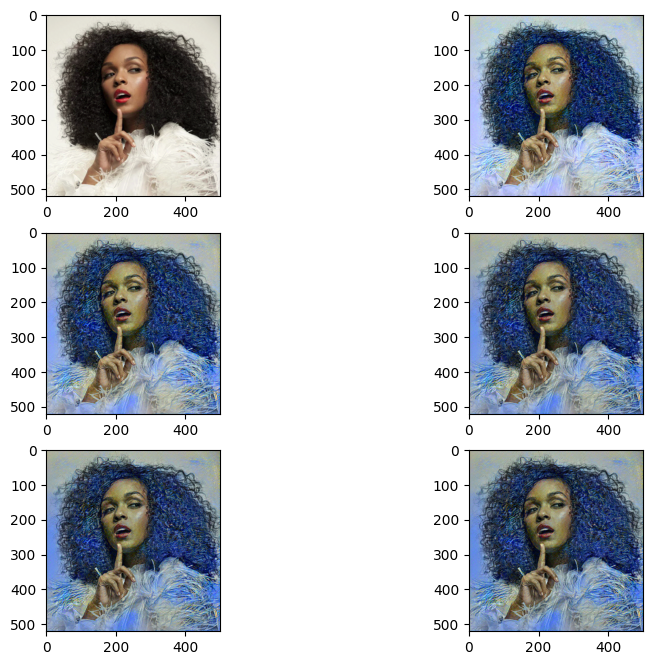

In [ ]:
for i in range(epochs):
    optimizer.step(closure)
    if i % show_every == 0:
        t_loss = closure()  # Calculate losses
        print("Epoch [{}/{}], Total Loss: {:.4f}".format(i, epochs, t_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()


In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***lbfgs with 1000 iteration with same wights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

In [ ]:
vgg=vgg.features
print(vgg)

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


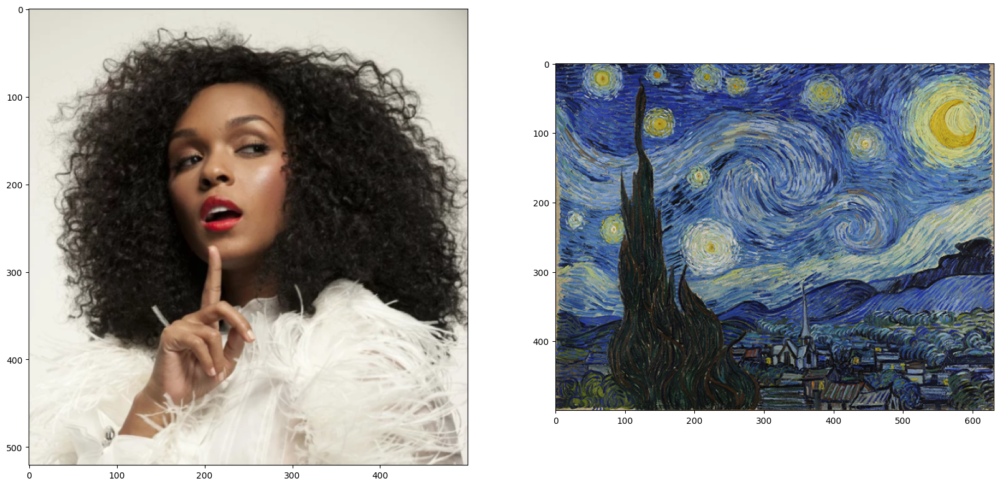

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer = optim.LBFGS([target.requires_grad_()])
alpha = 1
beta = 1e5
epochs = 1000
show_every = 200

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

In [ ]:
results=[]
def closure():
    global target
    optimizer.zero_grad()
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    t_loss.backward()
    return t_loss

Iteration [0/1000], Total Loss: 5308006.5000
Iteration [200/1000], Total Loss: 4262.4429
Iteration [400/1000], Total Loss: 3935.6465
Iteration [600/1000], Total Loss: 3877.1897
Iteration [800/1000], Total Loss: 3855.0149


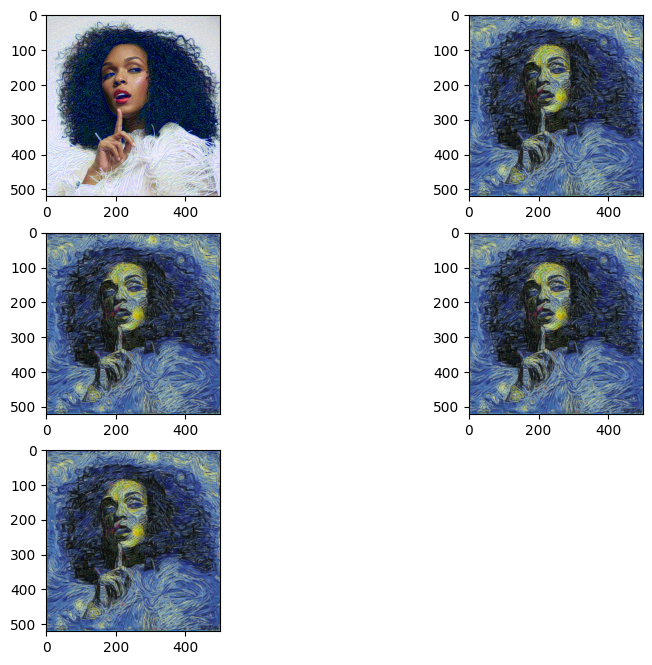

In [ ]:
for i in range(epochs):
    optimizer.step(closure)
    if i % show_every == 0:
        t_loss = closure()  # Calculate losses
        print("Iteration [{}/{}], Total Loss: {:.4f}".format(i, epochs, t_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()


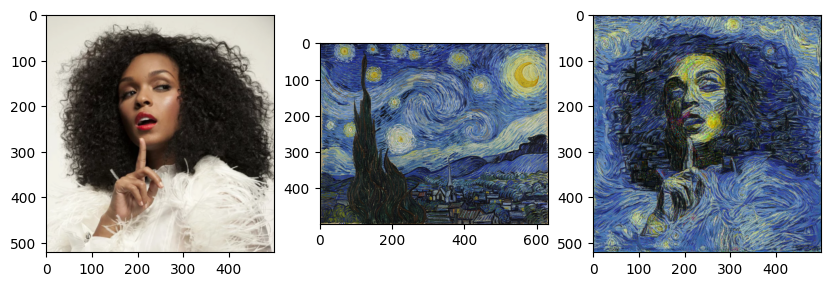

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

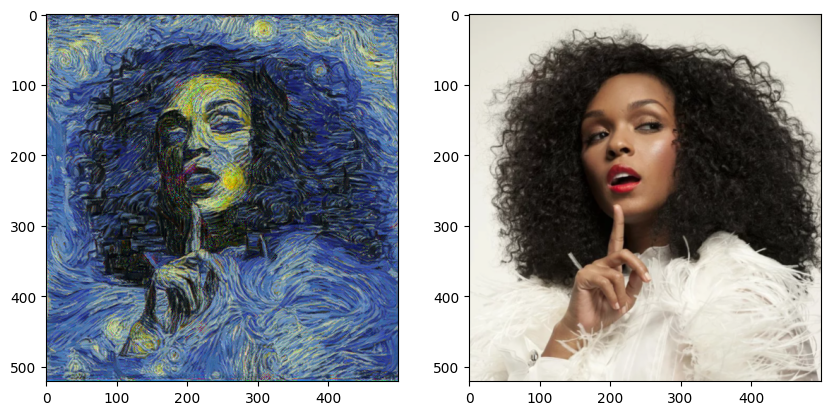

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***lbfgs with 1000 iteration with chnage in wights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


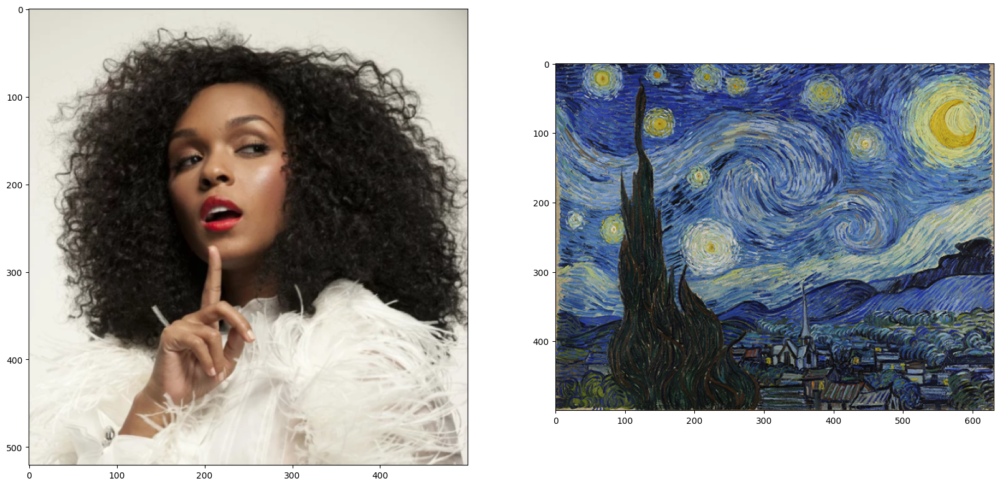

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer = optim.LBFGS([target.requires_grad_()])
alpha = 1
beta = 1e5
epochs = 1000
show_every = 200

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

In [ ]:
results=[]
def closure():
    global target
    optimizer.zero_grad()
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    t_loss.backward()
    return t_loss

In [ ]:
for i in range(epochs):
    optimizer.step(closure)
    if i % show_every == 0:
        t_loss = closure()  # Calculate losses
        print("Iteration [{}/{}], Total Loss: {:.4f}".format(i, epochs, t_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()


Iteration [0/1000], Total Loss: 4187263.7500


In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***adam with 3000 iteration***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


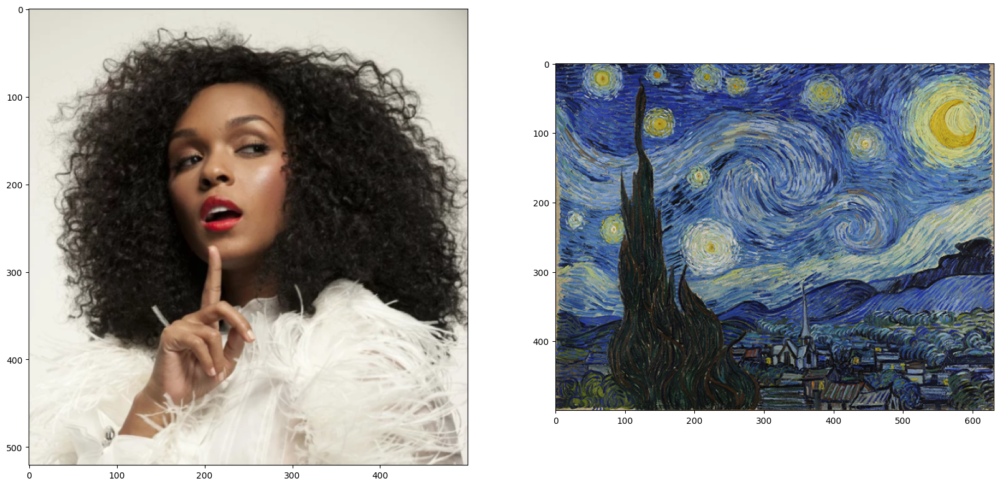

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer=optim.Adam([target],lr=0.003)
alpha=1
beta=1e5
epochs=3000
show_every=500

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

Epoch [0/3000], Total Loss: 115680520.0000, Content Loss: 0.0000, Style Loss: 1156.8052
Epoch [500/3000], Total Loss: 4896123.0000, Content Loss: 6.1715, Style Loss: 48.9612
Epoch [1000/3000], Total Loss: 1941127.5000, Content Loss: 6.9559, Style Loss: 19.4112
Epoch [1500/3000], Total Loss: 1293001.2500, Content Loss: 7.3836, Style Loss: 12.9299
Epoch [2000/3000], Total Loss: 882619.1250, Content Loss: 7.6748, Style Loss: 8.8261
Epoch [2500/3000], Total Loss: 606854.0625, Content Loss: 7.9186, Style Loss: 6.0685


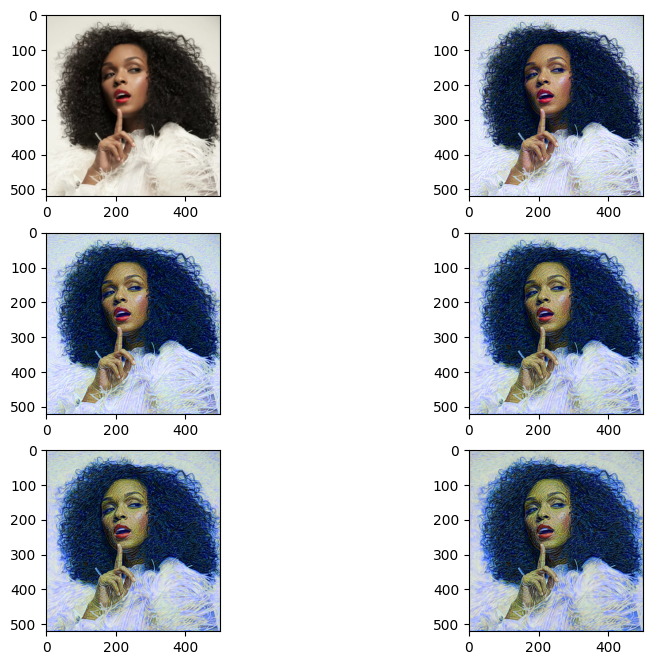

In [ ]:
results = []
for i in range(epochs):
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    optimizer.zero_grad()
    t_loss.backward()
    optimizer.step()
    if i % show_every == 0:
        print("Epoch [{}/{}], Total Loss: {:.4f}, Content Loss: {:.4f}, Style Loss: {:.4f}"
              .format(i, epochs, t_loss.item(), c_loss.item(), s_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()

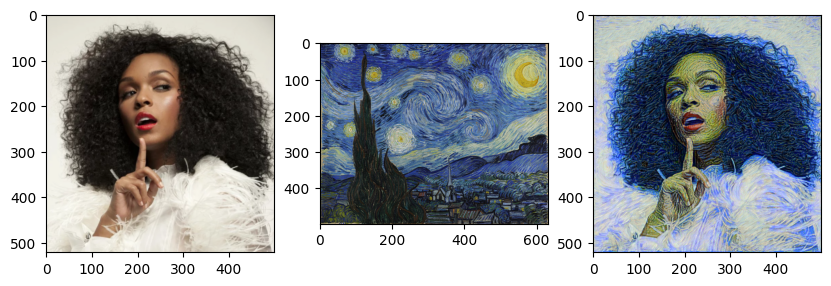

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

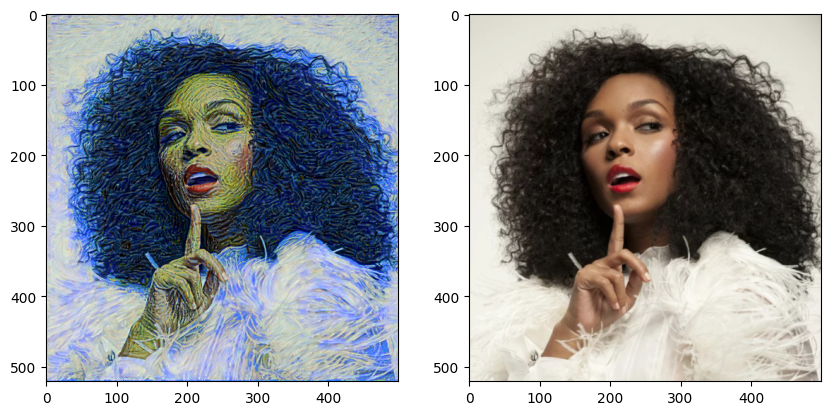

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***adam with 3000 iteration with change in weights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

In [ ]:
vgg=vgg.features
print(vgg)

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

In [ ]:
vgg.to(device)

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

In [ ]:
from torch import optim
optimizer=optim.Adam([target],lr=0.001)
alpha=5e5
beta=10e2
epochs=3000
show_every=500

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

In [ ]:
results = []
for i in range(epochs):
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    optimizer.zero_grad()
    t_loss.backward()
    optimizer.step()
    if i % show_every == 0:
        print("Iteration [{}/{}], Total Loss: {:.4f}, Content Loss: {:.4f}, Style Loss: {:.4f}"
              .format(i, epochs, t_loss.item(), c_loss.item(), s_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***adam with 6000 iteration***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


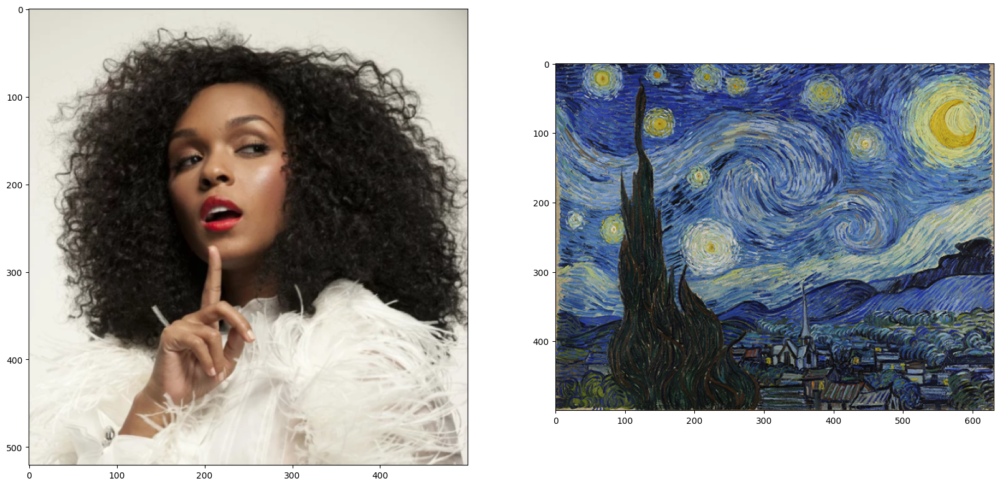

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer=optim.Adam([target],lr=0.003)
alpha=1
beta=1e5
epochs=6000
show_every=1000

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

Iteration [0/6000], Total Loss: 115680520.0000, Content Loss: 0.0000, Style Loss: 1156.8052
Iteration [1000/6000], Total Loss: 1940983.3750, Content Loss: 6.9595, Style Loss: 19.4098
Iteration [2000/6000], Total Loss: 882441.5625, Content Loss: 7.6882, Style Loss: 8.8243
Iteration [3000/6000], Total Loss: 423097.5312, Content Loss: 8.1125, Style Loss: 4.2309
Iteration [4000/6000], Total Loss: 216157.2969, Content Loss: 8.3863, Style Loss: 2.1615
Iteration [5000/6000], Total Loss: 117174.7188, Content Loss: 8.5713, Style Loss: 1.1717


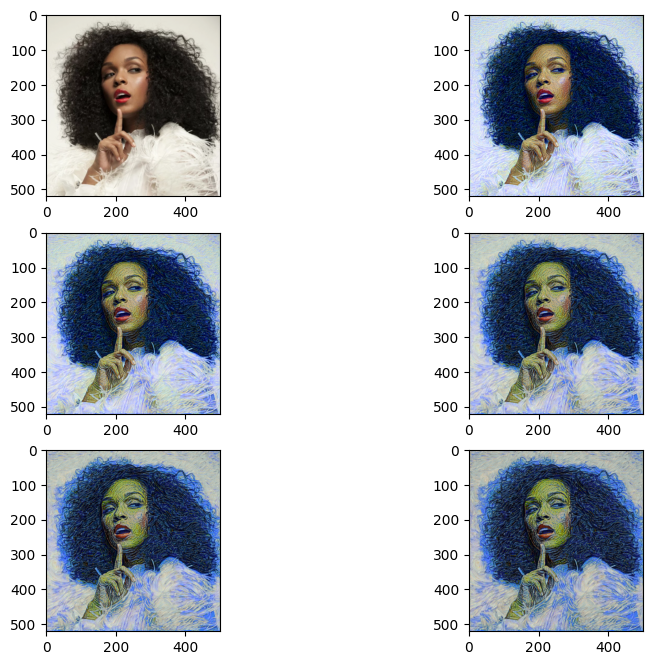

In [ ]:
results = []
for i in range(epochs):
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    optimizer.zero_grad()
    t_loss.backward()
    optimizer.step()
    if i % show_every == 0:
        print("Iteration [{}/{}], Total Loss: {:.4f}, Content Loss: {:.4f}, Style Loss: {:.4f}"
              .format(i, epochs, t_loss.item(), c_loss.item(), s_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()

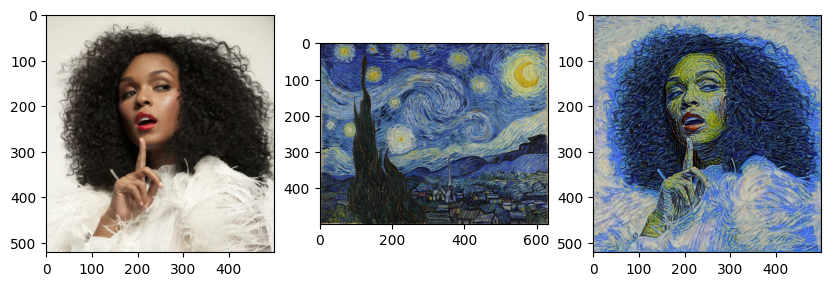

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

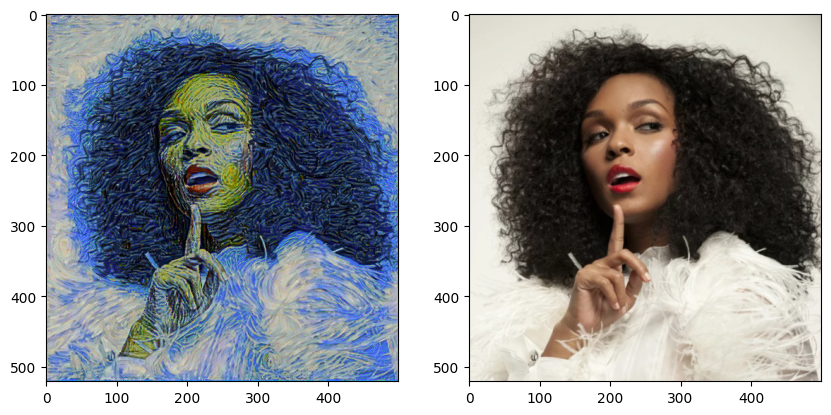

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)

# ***adam with 6000 iteration with change in weights***

In [ ]:
!pip install torch torchvision

In [ ]:
import torch
from torchvision import models
vgg=models.vgg19(pretrained=True)
print(vgg)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [ ]:
vgg=vgg.features
print(vgg)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
for parameters in vgg.parameters():
  parameters.requires_grad_(False)


In [ ]:
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
from PIL import Image
from torchvision import transforms as T

def preprocess(img_path,max_size = 500):
  image=Image.open(img_path).convert('RGB')
  if max(image.size)>max_size:
    size=max_size
  else:
    size=max(image.size)
  img_transforms=T.Compose([
        T.Resize(size),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406],
                    std=[0.229, 0.224, 0.225])
  ])
  image=img_transforms(image)
  image=image.unsqueeze(0)
  return image

In [ ]:
content_p=preprocess('/content/1-content.png')
style_p=preprocess('/content/1-style.jpg')
content_p=content_p.to(device)
style_p=style_p.to(device)
print("Content Shape",content_p.shape)
print("Style Shape", style_p.shape)

Content Shape torch.Size([1, 3, 521, 500])
Style Shape torch.Size([1, 3, 500, 631])


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def deprocess(tensor):
  image=tensor.to('cpu').clone()
  image=image.numpy()
  image=image.squeeze(0)

  image=image.transpose(1,2,0)
  image=image * np.array([0.229, 0.224, 0.225]) + np.array([0.485,0.456,0.406])
  image=image.clip(0,1)

  return image

In [ ]:
content_d=deprocess(content_p)
style_d=deprocess(style_p)
print("Deprocess content : ",content_d.shape)
print("Deprocess style : ",style_d.shape)

Deprocess content :  (521, 500, 3)
Deprocess style :  (500, 631, 3)


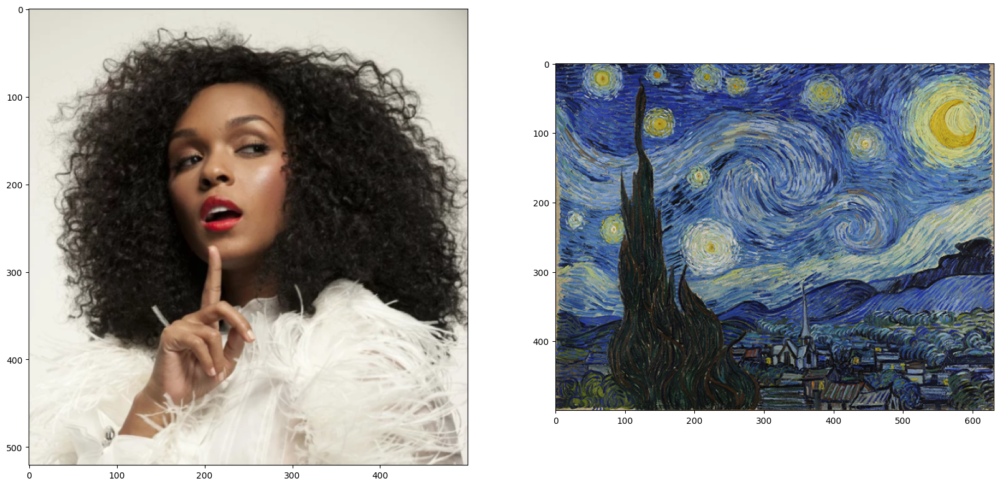

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,10))
ax1.imshow(content_d)
ax2.imshow(style_d)

In [ ]:
def get_features(image, model):
  layers={
      '0':'conv1_1',
      '5':'conv2_1',
      '10':'conv3_1',
      '19':'conv4_1',
      '21':'conv4_2', #content_feature
      '28':'conv5_1'}
  x=image
  Features={}
  for name,layer in model._modules.items():
    x=layer(x)
    if name in layers:
      Features[layers[name]]=x
  return Features

In [ ]:
content_f=get_features(content_p,vgg)
style_f=get_features(style_p,vgg)

In [ ]:
def gram_matrix(tensor):
  b,c,h,w=tensor.size()
  tensor=tensor.view(c,h*w)
  gram=torch.mm(tensor,tensor.t())
  return gram

In [ ]:
style_grams={layer:gram_matrix(style_f[layer]) for layer in style_f}

In [ ]:
def content_loss(target_conv4_2,content_conv4_2):
  loss=torch.mean((target_conv4_2-content_conv4_2)**2)
  return loss

In [ ]:
style_weights={
    'conv1_1':1.0,
    'conv2_1':0.75,
    'conv3_1':0.2,
    'conv4_1':0.2,
    'conv5_1':0.2
}

In [ ]:
def style_loss(style_weights,target_features,style_grams):

  loss=0

  for layer in style_weights:
    target_f=target_features[layer]
    target_gram=gram_matrix(target_f)
    style_gram=style_grams[layer]
    b,c,h,w=target_f.shape
    layer_loss=style_weights[layer] * torch.mean((target_gram - style_gram)**2)
    loss+=layer_loss/(c*h*w)

  return loss

In [ ]:
target=content_p.clone().requires_grad_(True).to(device)
target_f=get_features(target,vgg)
print("Content Loss: ",content_loss(target_f['conv4_2'],content_f['conv4_2']))
print("Style Loss: ",style_loss(style_weights,target_f,style_grams))

Content Loss:  tensor(0., device='cuda:0', grad_fn=<MeanBackward0>)
Style Loss:  tensor(1156.8052, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
from torch import optim
optimizer=optim.Adam([target],lr=0.001)
alpha=5e5
beta=1e2
epochs=6000
show_every=1000

In [ ]:
def total_loss(c_loss,s_loss,alpha,beta):
  loss=alpha*c_loss+beta*s_loss
  return loss

Iteration [0/6000], Total Loss: 115680.5156, Content Loss: 0.0000, Style Loss: 1156.8052
Iteration [1000/6000], Total Loss: 34821.6797, Content Loss: 0.0116, Style Loss: 290.1237
Iteration [2000/6000], Total Loss: 19859.5859, Content Loss: 0.0092, Style Loss: 152.3782
Iteration [3000/6000], Total Loss: 14029.5400, Content Loss: 0.0080, Style Loss: 100.3280
Iteration [4000/6000], Total Loss: 11734.6221, Content Loss: 0.0072, Style Loss: 81.2722
Iteration [5000/6000], Total Loss: 10613.2617, Content Loss: 0.0067, Style Loss: 72.6217


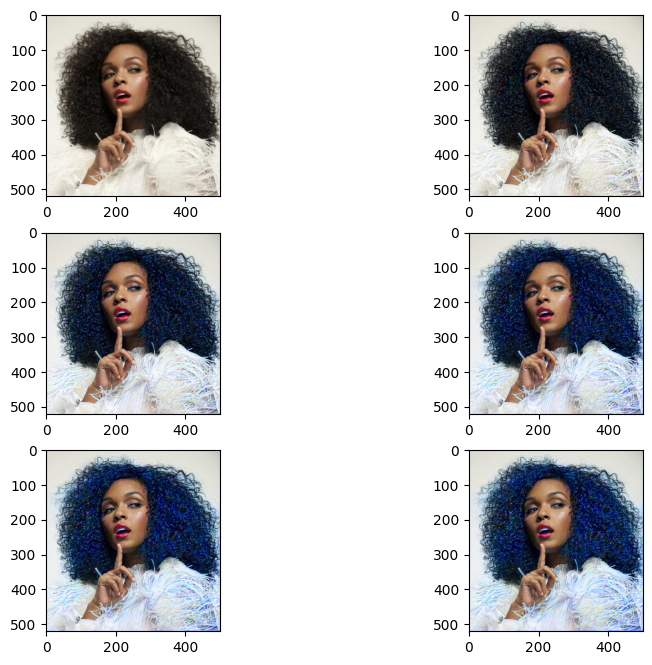

In [ ]:
results = []
for i in range(epochs):
    target_f = get_features(target, vgg)
    c_loss = content_loss(target_f['conv4_2'], content_f['conv4_2'])
    s_loss = style_loss(style_weights, target_f, style_grams)
    t_loss = total_loss(c_loss, s_loss, alpha, beta)
    optimizer.zero_grad()
    t_loss.backward()
    optimizer.step()
    if i % show_every == 0:
        print("Iteration [{}/{}], Total Loss: {:.4f}, Content Loss: {:.4f}, Style Loss: {:.4f}"
              .format(i, epochs, t_loss.item(), c_loss.item(), s_loss.item()))
        results.append(deprocess(target.detach()))

plt.figure(figsize=(10, 8))
for i in range(len(results)):
    plt.subplot(3, 2, i + 1)
    plt.imshow(results[i])
plt.show()

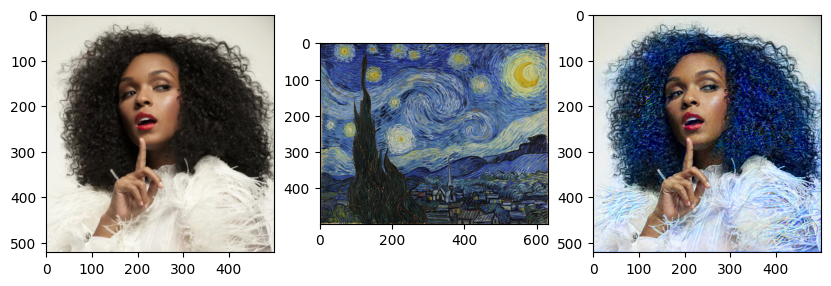

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(10,5))
ax1.imshow(content_copy)
ax2.imshow(style_d)
ax3.imshow(target_copy)
plt.show()

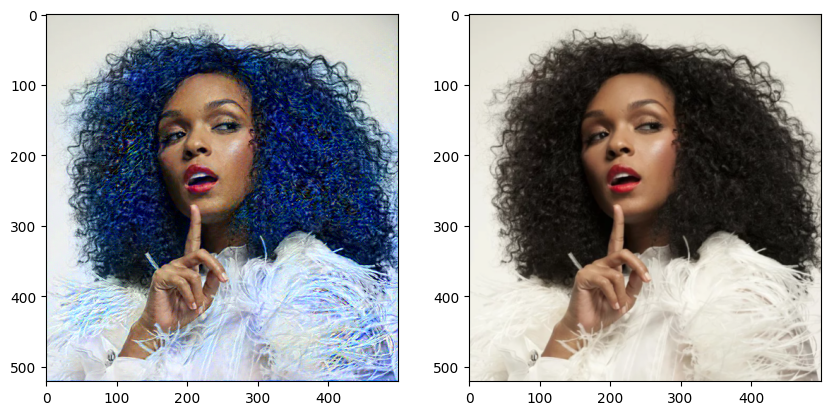

In [ ]:
target_copy=deprocess(target.detach())
content_copy=deprocess(content_p)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
ax1.imshow(target_copy)
ax2.imshow(content_copy)